## Setup

In [1]:
# use full window width
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

# POLICY SEARCH AGENT
## An AI agent that updates its policy model with each episode

Charles Varley, 2391567v

In [87]:
'''
Imports
'''
#!pip install q tensorflow==1.15
#!pip install q keras==2.2.4

import os
os.chdir('..')
import virl
import utils

import matplotlib.pyplot as plt
import time
import itertools
import matplotlib
from mpl_toolkits.mplot3d import Axes3D
from collections import deque

import numpy as np
import sys
import random
from collections import namedtuple
import collections
import copy

# Import the open AI gym
import gym
from gym.envs.toy_text import discrete

import keras
from keras.models import Sequential
from keras.optimizers import Adam
from keras import layers
from keras.models import Model
from keras import backend as K
from keras import utils as np_utils
from keras import optimizers
from keras import initializers

import tensorflow as tf

# Policy Class

In [40]:
def create_policy(func_approximator):
    """
    Create a greedy policy with the exploration defined by the epsilon and nA parameters
    
    args:
    - func_approximator: a function approximator that gives the probability Q(s, a) for a given state s
    - num_actions: the number of actions
    
    return: A policy function. Policy functions take a state as input and return an action to perform.
    """
    
    def policy_fn(state):
        """
        Perform an action.
        
        Returns: q_values is the actual value returned by the approximator.
        """
        q_values = func_approximator.predict(func_approximator.get_onehot_state_encoding(state))
        return q_values
    
    return policy_fn

# Function Approximator (Tabular Methods)

In [80]:
class FunctionApproximator:
    """
    Approximate Q(s, a) with a neural network
    """
    
    def __init__(self, bin_scaler=8, eta0=0.01):
        """
        Set up the function approximator.
        
        args:
        - bins: number of discrete state values
        - eta0: (initial) learning rate.
        """
        
         # Neural network vars
        self.n_actions = 4
        self.neurons = []
        self.alpha = eta0
        
        # Discretize state space vars
        self.population = 6e8
        self.__build_bins(bin_scaler)
        self.n_states = len(self.bins)**4
        
        # Build and train neural network
        self.__build_model()
        self.__build_train_fn()
        
        # observation_examples = np.array([env.observation_space.sample() for x in range(10000)])
        
        self.__build_model()
        self.__build_train_fn()
      
    '''
    Tabular methods implementation of build_model = constructing a neural network
    Creates a stochastic policy representation that is differentiable, using softmax function
    '''
    def __build_model(self):
        # n_states = len(self.bins)**4 # each state can occupy a bin, total n = n_bins[0] * n_bins[1] + ...
        self.X = layers.Input(shape=(self.n_states,))
        net = self.X
        for h_dim in self.neurons:
            net = layers.Dense(h_dim)(net)
            net = layers.Activation("relu")(net)
        net = layers.Dense(self.n_actions, kernel_initializer=initializers.Zeros())(net)
        net = layers.Activation("softmax")(net)
        self.model = Model(inputs=self.X, outputs=net)
        
    '''
    Tabular methods implementation of build_fn = training the neural network
    Custom train function that that replaces `model.fit(X, y)`because we use the output of model and use it for training
    Called using self.train_fn([state, action_one_hot, target])` which would train the model
    '''
    def __build_train_fn(self):
        # predefine a few variables
        action_onehot_placeholder = K.placeholder(shape=(None, self.n_actions),name="action_onehot") # define a variable
        target = K.placeholder(shape=(None,), name="target") # define a variable       
        
        # this part defines the loss and is very important!
        action_prob = self.model.output # the outpout of the neural network        
        action_selected_prob = K.sum(action_prob * action_onehot_placeholder, axis=1) # probability of the selcted action        
        log_action_prob = K.log(action_selected_prob) # take the log
        loss = -log_action_prob * target # the loss we are trying to minimise
        loss = K.mean(loss)
        
        # defining the speific optimizer to use
        adam = optimizers.Adam(lr=self.alpha)# clipnorm=1000.0) # let's use a kereas optimiser called Adam
        updates = adam.get_updates(params=self.model.trainable_weights, loss=loss) # what gradient updates to we parse to Adam
            
        # create a handle to the optimiser function    
        self.train_fn = K.function(inputs=[self.model.input, action_onehot_placeholder, target], 
                                   outputs=[],
                                   updates=updates) # return a function which, when called, takes a gradient step
    
    '''
    Tabular methods requires a set of bins with which to digitize the state space, the choice of the bins is very 
    important for this because having a good range of bins to put values into will help the model to make predictions,
    a design choice for this solution is to create a set of bins by dividing the bin by some integer each loop will 
    allow for lots of bins to be created at the low-end of the population size
    '''
    def __build_bins(self, scaler):
        bins = [0]
        b = scaler
        while b < 20000: # Bins between 20k and population aren't needed
            bins.append(b)
            b *= scaler
        bins.append(self.population)
        self.bins = bins
        # print("bins: {}".format(self.bins))
    
    '''
    Tabular methods using discretized state space, digitizes a state into a set of bins
    Then encodes the state as one-hot to give to the model for updating or predictions 
    '''
    def get_onehot_state_encoding(self, state):
        # Digitize the state space (put into discrete set of bins)
        digitized_state = np.digitize(state, self.bins) - 1
        
        # Calculate index of onehot state space to set to 1
        onehot_index = sum((len(self.bins)-1)**i * bin_value for i, bin_value in enumerate(digitized_state))
        
        # Create onehot encoding of state space..
        state_onehot = np.zeros((1, self.n_states), dtype=np.bool)
        state_onehot[0, onehot_index] = 1.0
        return state_onehot     
        
        
    def predict(self, s, a = None):
        """
        Perform a prediction according to the approximation of Q(s, a)
        
        Args:
        - s: state to make predictions from extracted from the state space.
        - a: (Optional) action to make a prediction for.
        
        Return:
        - if a is not provided a list of scores of each action
        - if a is provided only the specific score of that action.
        """
        if a is None:
            return self.model.predict(s).squeeze()
        else:   
            return self.model.predict(s)[a]
    
    def update(self, s, a, y):
        """
        Update the model's parameters for a given state and action towards the target
        """
        self.train_fn([s, a, y]) # call the custom optimiser which takes a gradient step

# Policy Search

In [14]:
EpisodeStats = namedtuple("Stats", ["episode_lengths", "episode_rewards"])

def policy_search(env, func_approximator, num_episodes, discount_factor=1.0):
    """
    Policy search algo for policy search using a generic function approximation.
    """

    np.random.seed(GLOBAL_SEED)
    
    stats = EpisodeStats(
        episode_lengths=np.zeros(num_episodes),
        episode_rewards=np.zeros(num_episodes))

    # Namedtuple to hold transition information made at each step in simulation
    Transition = collections.namedtuple("Transition", ["state", "action", "reward", "next_state", "done"])
    
    for i_episode in range(num_episodes):
        # Run episode, memorising the transitions made at each step
        # At end of episode, update the policy
        state = env.reset()
        episode = []
        
        for t in itertools.count():
            # Take a step
            state_oh = func_approximator.get_onehot_state_encoding(state)                                   
            action_probs = func_approximator.predict(state_oh)
            
            action = np.random.choice(np.arange(len(action_probs)), p=action_probs)

            # Perform the action
            next_state, reward, done, _ = env.step(action)

            # Keep track of the transition
            episode.append(Transition(
              state=state, action=action, reward=reward, next_state=next_state, done=done))
            
            # Update statistics
            stats.episode_rewards[i_episode] += reward
            stats.episode_lengths[i_episode] = t

            if done:
                break

            state = next_state
           
        #if i_episode % (num_episodes/10) == 0:
            # print("\rEpisode {} ({})".format(i_episode+1, str(stats.episode_rewards[i_episode])))
            #print("{}% done.".format(int((100*i_episode)/num_episodes)))
            
        # Go through the episode, step-by-step and make policy updates (note we sometime use j for the individual steps)
        for t, transition in enumerate(episode):
            state_oh = func_approximator.get_onehot_state_encoding(transition.state)
            action_oh = np_utils.to_categorical(transition.action, num_classes=4) 
            
            # The return, G_t, after this timestep; this is the target for the PolicyEstimator
            G_t = sum(discount_factor**i * t.reward for i, t in enumerate(episode[t:]))
           
            # Update our policy estimator
            func_approximator.update(state_oh, action_oh, np.array(G_t))  
            
    #print("")
    #best_i = np.argmax(stats.episode_rewards)
    #print("Best episode: Episode {0} ({1})".format(best_i+1, stats.episode_rewards[best_i]))
    #print("")
    
    return stats

# Training (alpha/gamma proportional to num_episodes)

In [ ]:
env = virl.Epidemic(stochastic=False, noisy=False)
GLOBAL_SEED = 42

num_episodes = 100

approximator_ps = FunctionApproximator(eta0=(1/num_episodes))
stats = policy_search(env, approximator_ps, num_episodes, discount_factor=(1-(1/num_episodes)))
plt.plot(stats.episode_rewards)
utils.evaluate(create_policy(approximator_ps))

# Analysis

In [ ]:
utils.evaluate(create_policy(approximator_ps), full_eval=True)   

# Training (set alpha/gamma, small num_episodes)

In [ ]:
env = virl.Epidemic(stochastic=False, noisy=False)
GLOBAL_SEED = 42

num_episodes = 100

approximator_ps = FunctionApproximator(bin_scaler=10, eta0=0.01)
stats = policy_search(env, approximator_ps, num_episodes, discount_factor=0.99)
plt.plot(stats.episode_rewards)
utils.evaluate(create_policy(approximator_ps))

# Testing various bin scaler values: scaler = 2

In [ ]:
env = virl.Epidemic(stochastic=False, noisy=False)
GLOBAL_SEED = 42

num_episodes = 1000

approximator_ps = FunctionApproximator(bin_scaler=2, eta0=0.01)
stats = policy_search(env, approximator_ps, num_episodes, discount_factor=0.99)
plt.plot(stats.episode_rewards)
utils.evaluate(create_policy(approximator_ps))

# Testing various bin scaler values: scaler = 3

In [ ]:
env = virl.Epidemic(stochastic=False, noisy=False)
GLOBAL_SEED = 42

num_episodes = 1000

approximator_ps = FunctionApproximator(bin_scaler=3, eta0=0.01)
stats = policy_search(env, approximator_ps, num_episodes, discount_factor=0.99)
plt.plot(stats.episode_rewards)
utils.evaluate(create_policy(approximator_ps))

# Testing various bin scaler values: scaler = 4

In [ ]:
# env = virl.Epidemic(stochastic=False, noisy=False)
GLOBAL_SEED = 42

num_episodes = 1000

approximator_ps = FunctionApproximator(bin_scaler=4, eta0=0.01)
stats = policy_search(env, approximator_ps, num_episodes, discount_factor=0.99)
plt.plot(stats.episode_rewards)
utils.evaluate(create_policy(approximator_ps))

# Testing various bin scaler values: scaler = 5

In [ ]:
env = virl.Epidemic(stochastic=False, noisy=False)
GLOBAL_SEED = 42

num_episodes = 1000

approximator_ps = FunctionApproximator(bin_scaler=5, eta0=0.01)
stats = policy_search(env, approximator_ps, num_episodes, discount_factor=0.99)
plt.plot(stats.episode_rewards)
utils.evaluate(create_policy(approximator_ps))

# Testing various bin scaler values: scaler = 10

In [ ]:
env = virl.Epidemic(stochastic=False, noisy=False)
GLOBAL_SEED = 42

num_episodes = 1000

approximator_ps = FunctionApproximator(bin_scaler=10, eta0=0.01)
stats = policy_search(env, approximator_ps, num_episodes, discount_factor=0.99)
plt.plot(stats.episode_rewards)
utils.evaluate(create_policy(approximator_ps))

# Reducing num_episodes

Agent seems to stop learning at around 100 episodes and it also seems to have moments where it teaches itself wrong things.

I think this is due to the learn rate being set to 0.01 which might be too large for the size of num_episodes, making this value proportional to num_episodes is probably the best solution.

In [ ]:
env = virl.Epidemic(stochastic=False, noisy=False)
GLOBAL_SEED = 42

num_episodes = 50

approximator_ps = FunctionApproximator(bin_scaler=2, eta0=(1/num_episodes))
stats = policy_search(env, approximator_ps, num_episodes, discount_factor=(1-(1/num_episodes)))
plt.plot(stats.episode_rewards)
utils.evaluate(create_policy(approximator_ps))

# Results (no noise, not stochastic)

Train and analyse agent for each problem

In [ ]:
results = []
row_labels = []

GLOBAL_SEED = 42
num_episodes = 80
    
for i in range(10):
    print("Executing problem {}".format(i))
    env = virl.Epidemic(stochastic=False, noisy=False, problem_id=i)
    
    approximator_ps = FunctionApproximator(bin_scaler=2, eta0=(1/num_episodes))
    stats = policy_search(env, approximator_ps, num_episodes, discount_factor=(1-(1/num_episodes)))
    plt.plot(stats.episode_rewards)
    utils.evaluate(create_policy(approximator_ps))
    
    res = utils.evaluate(create_policy(approximator_ps), full_eval=True, verbose=False)
    results.append([-1*r for r in res])
    row_labels.append("Trained on problem {}".format(i))

In [ ]:
print(utils.latex_table(results, row_labels, include_means=True))

# Results (not noisy, not stochastic) (fewer episodes, set alpha/gamma)

I think this agent stops improving at around 50 episodes, and I want to try a set alpha/gamma values again

In [ ]:
results = []
row_labels = []

GLOBAL_SEED = 42
num_episodes = 50
    
for i in range(10):
    print("Executing problem {}".format(i))
    env = virl.Epidemic(stochastic=False, noisy=False, problem_id=i)
    
    approximator_ps = FunctionApproximator(bin_scaler=2, eta0=0.01)
    stats = policy_search(env, approximator_ps, num_episodes, discount_factor=0.99)
    #plt.plot(stats.episode_rewards)
    #utils.evaluate(create_policy(approximator_ps))
    
    res = utils.evaluate(create_policy(approximator_ps), full_eval=True, verbose=False)
    results.append([-1*r for r in res])
    row_labels.append("Trained on problem {}".format(i))

In [100]:
print(utils.latex_table(results, row_labels, include_means=True))

Trained on problem 0 & 0.97 & 0.95 & 0.89 & 0.89 & 0.9 & 1.04 & 1.11 & 1.16 & 1.15 & 1.24 & 1.03\\ 
Trained on problem 1 & 1.02 & \textbf{0.64} & \textbf{0.68} & 0.77 & \textbf{0.83} & 1.54 & 1.25 & 1.87 & 2.25 & 2.31 & 1.32\\ 
Trained on problem 2 & 1.02 & 0.88 & 0.9 & 0.91 & 1.01 & 1.09 & 1.14 & 1.18 & 1.2 & 1.22 & 1.06\\ 
Trained on problem 3 & \textbf{0.94} & 0.82 & 0.77 & 0.88 & 0.87 & \textbf{1.0} & \textbf{1.05} & 1.71 & \textbf{1.13} & 1.42 & 1.06\\ 
Trained on problem 4 & 0.99 & 0.82 & 0.77 & \textbf{0.77} & 0.85 & 1.06 & 1.09 & 1.19 & 1.17 & \textbf{1.2} & \textbf{\underline{0.99}}\\ 
Trained on problem 5 & 1.02 & 1.02 & 1.03 & 0.78 & 0.87 & 1.04 & 1.1 & 1.18 & 1.16 & 1.21 & 1.04\\ 
Trained on problem 6 & 1.05 & 0.97 & 0.91 & 0.87 & 0.89 & 1.04 & 1.12 & 1.17 & 1.14 & 1.21 & 1.04\\ 
Trained on problem 7 & 1.05 & 1.06 & 1.03 & 0.99 & 1.07 & 1.05 & 1.07 & 1.17 & 1.16 & 1.21 & 1.09\\ 
Trained on problem 8 & 1.07 & 1.01 & 0.98 & 0.96 & 0.97 & 1.04 & 1.09 & \textbf{1.16} & 1.15 & 1

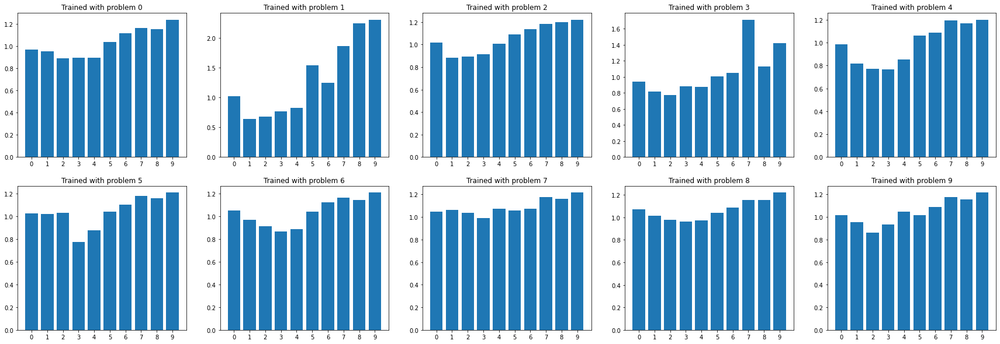

In [142]:
def plot_bars(results):
    fig, axes = plt.subplots(2, 5, figsize=(30, 10))
    for i, res in enumerate(results):
        axes[int(i/5),int(i%5)].bar(np.arange(10), res)
        axes[int(i/5),int(i%5)].set_xticks(np.arange(10))
        #axes[int(i/5),int(i%5)].set_xlabel('Problem ID')
        #axes[int(i/5),int(i%5)].set_ylabel('Total Reward')
        axes[int(i/5),int(i%5)].set_title("Trained with problem {}".format(i))
        
plot_bars(results)

# Results (noisy, not stochastic)

Executing problem 0
total reward -2.0335096878973706
total reward -0.6713091894990969
total reward -1.0653135223613337
total reward -1.3842209270949173
total reward -1.5096147760722514
total reward -2.192607273513415
total reward -2.300652774653258
total reward -2.4953163646394105
total reward -2.2039892853012115
total reward -2.4264443355025174
Executing problem 1
total reward -1.3546722984503186
total reward -0.38948901670431435
total reward -0.5959614025139001
total reward -0.6152769043266642
total reward -1.1056077032705023
total reward -1.7353103397788994
total reward -2.0321908636808423
total reward -2.0583200602737266
total reward -2.116650948830501
total reward -2.1147121463370366
Executing problem 2
total reward -1.4376234076192795
total reward -0.4963851953157173
total reward -0.659772425059908
total reward -0.6916966757275166
total reward -0.8341390063714795
total reward -1.5239562503640218
total reward -2.1531603564651025
total reward -2.1444843527733815
total reward -2.294

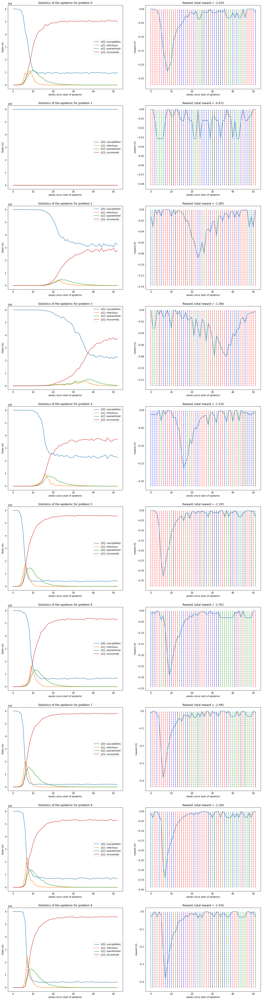

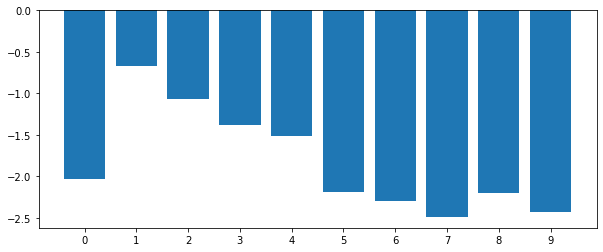

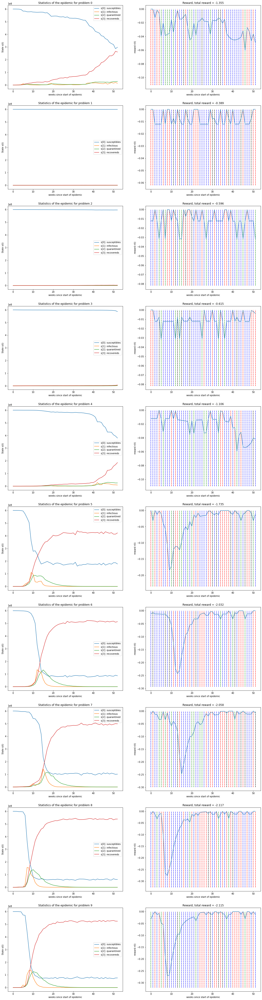

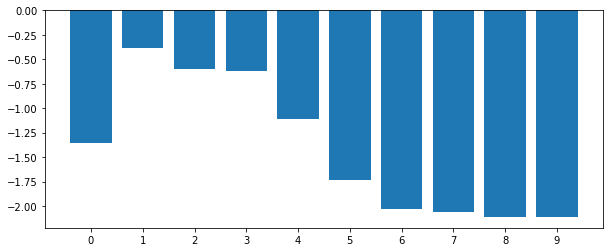

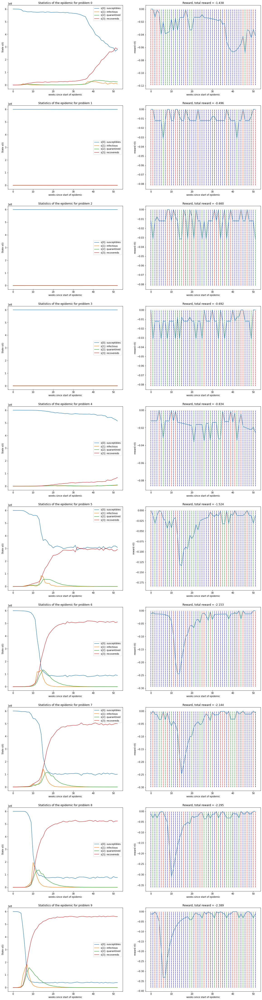

...

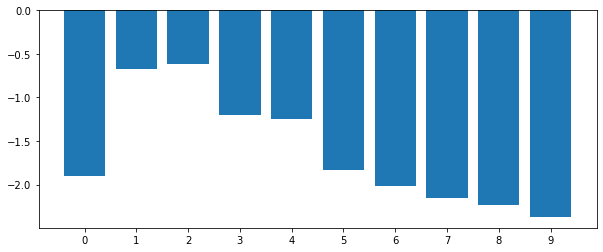

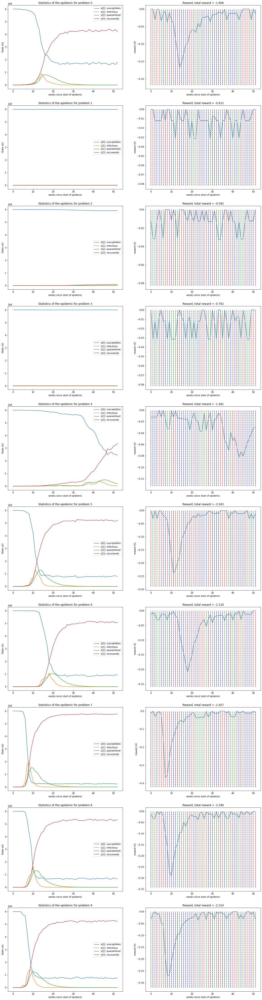

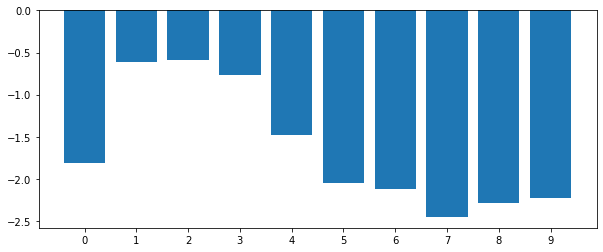

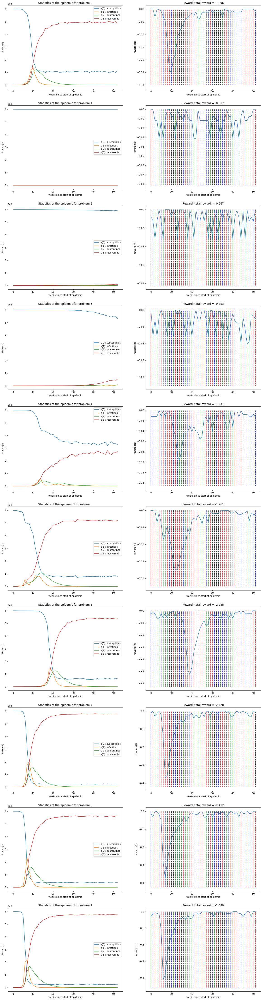

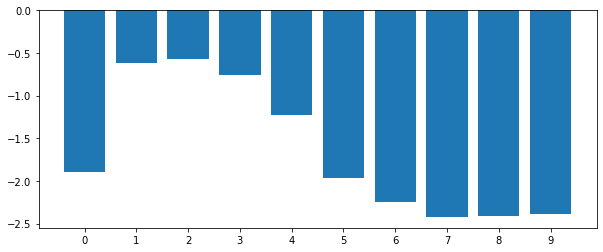

In [101]:
results_noisy = []
row_labels = []

GLOBAL_SEED = 42
num_episodes = 50
    
for i in range(10):
    print("Executing problem {}".format(i))
    env = virl.Epidemic(stochastic=False, noisy=True, problem_id=i)
    
    approximator_ps = FunctionApproximator(bin_scaler=2, eta0=0.01)
    stats = policy_search(env, approximator_ps, num_episodes, discount_factor=0.99)
    #plt.plot(stats.episode_rewards)
    #utils.evaluate(create_policy(approximator_ps), noisy=True)
    
    res = utils.evaluate(create_policy(approximator_ps), full_eval=True, verbose=False, noisy=True)
    results_noisy.append([-1*r for r in res])
    row_labels.append("Trained on problem {}".format(i))

In [102]:
print(utils.latex_table(results_noisy, row_labels, include_means=True))

Trained on problem 0 & 2.03 & 0.67 & 1.07 & 1.38 & 1.51 & 2.19 & 2.3 & 2.5 & 2.2 & 2.43 & 1.83\\ 
Trained on problem 1 & 1.35 & \textbf{0.39} & 0.6 & \textbf{0.62} & 1.11 & 1.74 & 2.03 & 2.06 & 2.12 & 2.11 & 1.41\\ 
Trained on problem 2 & 1.44 & 0.5 & 0.66 & 0.69 & 0.83 & \textbf{1.52} & 2.15 & 2.14 & 2.29 & 2.39 & 1.46\\ 
Trained on problem 3 & 1.37 & 0.68 & 0.66 & 0.63 & \textbf{0.74} & 1.64 & 1.77 & 1.82 & 2.3 & 2.16 & 1.38\\ 
Trained on problem 4 & \textbf{0.93} & 0.63 & 0.8 & 0.7 & 0.83 & 1.61 & \textbf{1.53} & \textbf{1.75} & 2.48 & \textbf{1.77} & \textbf{\underline{1.3}}\\ 
Trained on problem 5 & 1.89 & 0.57 & 0.82 & 1.13 & 1.7 & 1.87 & 2.01 & 2.22 & 2.28 & 2.17 & 1.67\\ 
Trained on problem 6 & 1.87 & 0.64 & 1.07 & 1.22 & 1.61 & 2.12 & 2.05 & 2.17 & \textbf{2.07} & 2.26 & 1.71\\ 
Trained on problem 7 & 1.91 & 0.67 & 0.62 & 1.2 & 1.25 & 1.84 & 2.02 & 2.15 & 2.23 & 2.38 & 1.63\\ 
Trained on problem 8 & 1.81 & 0.61 & 0.59 & 0.76 & 1.48 & 2.04 & 2.12 & 2.46 & 2.29 & 2.22 & 1.64\\ 


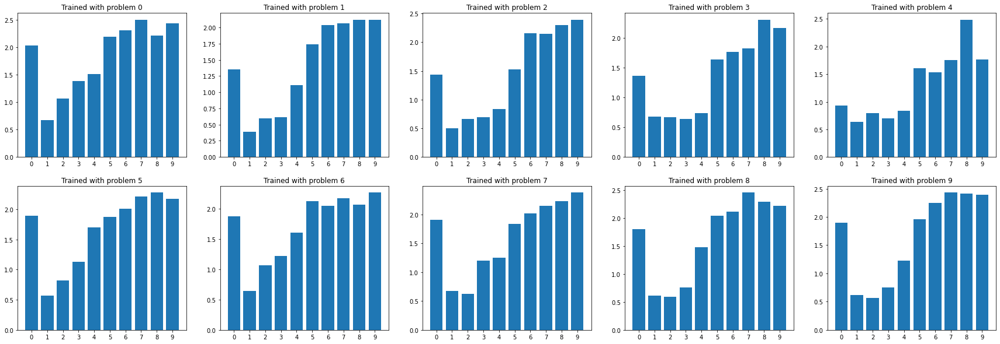

In [139]:
plot_bars(results_noisy)

# Results (not noisy, stochastic)

Executing problem 0
total reward -0.979463606372315
total reward -0.6971835977968907
total reward -0.6741789744632725
total reward -0.7682653918757045
total reward -0.8420993603460488
total reward -1.4396391735411493
total reward -2.035169146056374
total reward -1.4923197332298794
total reward -1.892248878357201
total reward -2.315019913416864
Executing problem 1
total reward -0.890689295739485
total reward -0.9009790492662288
total reward -0.833329020070289
total reward -0.7488707666341039
total reward -0.8486421975604239
total reward -1.2219471778151223
total reward -1.849167373130978
total reward -1.116389363575366
total reward -1.871866697214691
total reward -2.194256921809665
Executing problem 2
total reward -1.2644804223156796
total reward -0.7729567571296476
total reward -0.7084897685350167
total reward -0.6925680607902471
total reward -0.7816380897115219
total reward -1.5082363524097548
total reward -2.182442490031712
total reward -1.6681333807437488
total reward -1.96579723241

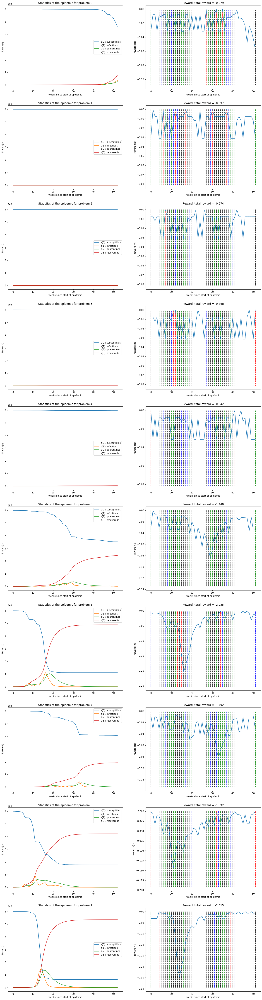

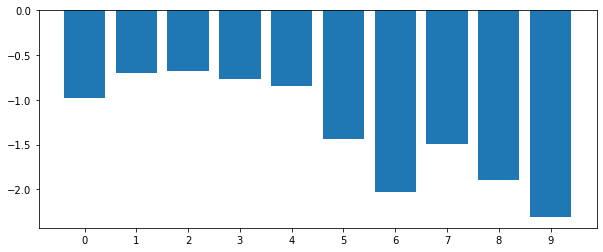

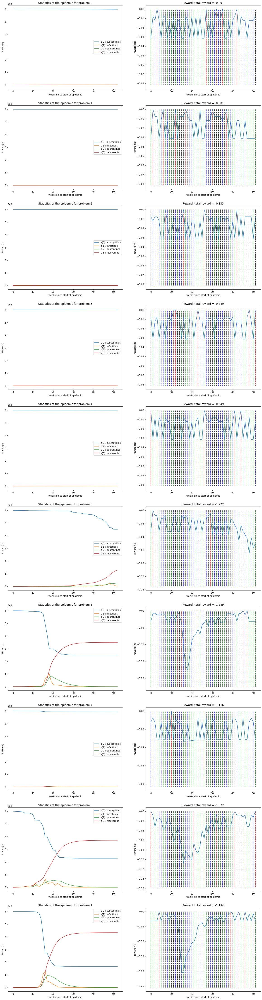

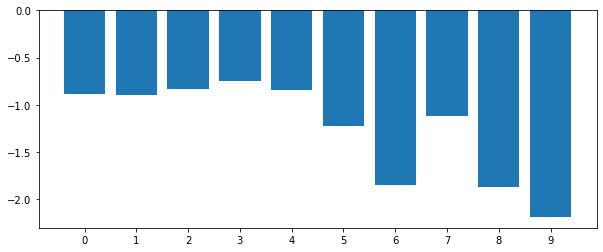

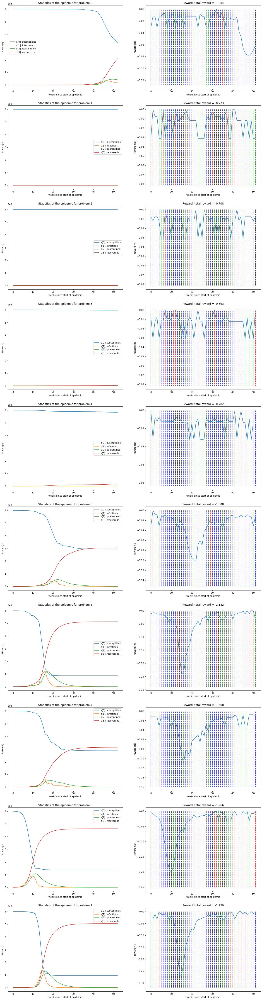

...

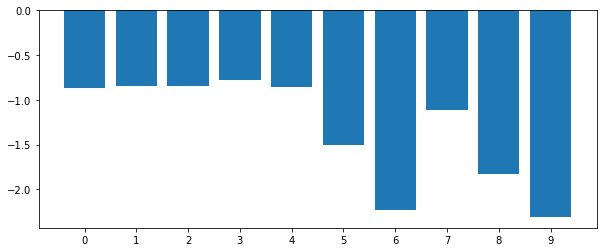

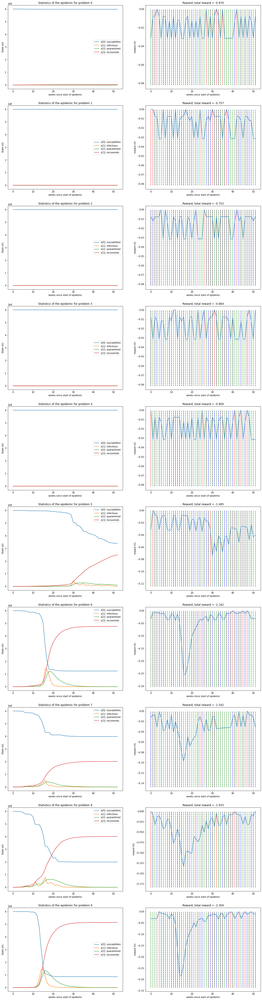

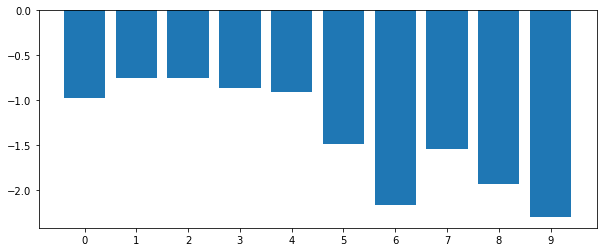

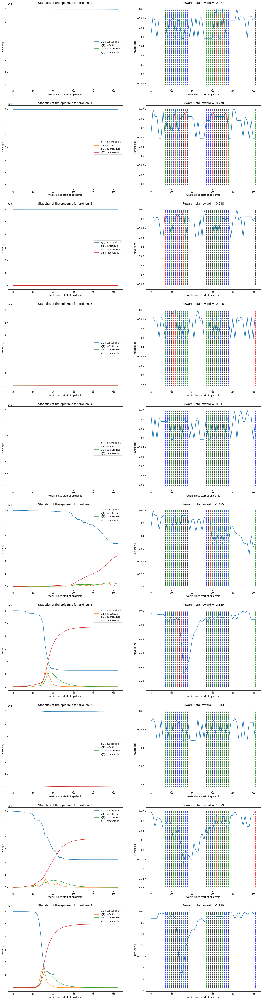

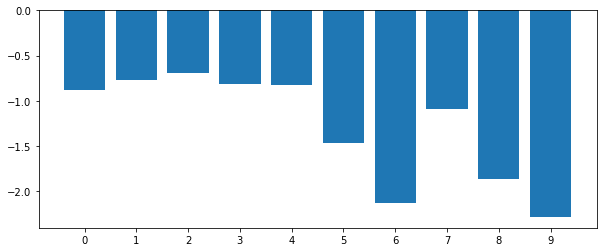

In [104]:
results_stochastic = []
row_labels = []

GLOBAL_SEED = 42
num_episodes = 50
    
for i in range(10):
    print("Executing problem {}".format(i))
    env = virl.Epidemic(stochastic=True, noisy=False, problem_id=i)
    
    approximator_ps = FunctionApproximator(bin_scaler=2, eta0=0.01)
    stats = policy_search(env, approximator_ps, num_episodes, discount_factor=0.99)
    #plt.plot(stats.episode_rewards)
    #utils.evaluate(create_policy(approximator_ps),)
    
    res = utils.evaluate(create_policy(approximator_ps), full_eval=True, verbose=False)
    results_stochastic.append([-1*r for r in res])
    row_labels.append("Trained on problem {}".format(i))

In [105]:
print(utils.latex_table(results_stochastic, row_labels, include_means=True))

Trained on problem 0 & 0.98 & 0.7 & 0.67 & 0.77 & 0.84 & 1.44 & 2.04 & 1.49 & 1.89 & 2.32 & 1.31\\ 
Trained on problem 1 & 0.89 & 0.9 & 0.83 & 0.75 & 0.85 & 1.22 & 1.85 & 1.12 & 1.87 & 2.19 & 1.25\\ 
Trained on problem 2 & 1.26 & 0.77 & 0.71 & 0.69 & \textbf{0.78} & 1.51 & 2.18 & 1.67 & 1.97 & 2.23 & 1.38\\ 
Trained on problem 3 & 1.35 & \textbf{0.61} & \textbf{0.58} & \textbf{0.66} & 0.9 & 1.7 & 2.02 & 1.99 & 2.05 & 2.17 & 1.4\\ 
Trained on problem 4 & 0.93 & 0.77 & 0.72 & 0.79 & 0.89 & \textbf{1.04} & 1.88 & \textbf{1.09} & 1.88 & 2.19 & \textbf{\underline{1.22}}\\ 
Trained on problem 5 & 1.2 & 0.7 & 0.59 & 0.67 & 0.9 & 1.65 & \textbf{1.82} & 1.95 & 1.93 & \textbf{2.04} & 1.34\\ 
Trained on problem 6 & 0.9 & 0.73 & 0.74 & 0.75 & 0.85 & 1.44 & 2.09 & 1.12 & 1.88 & 2.34 & 1.28\\ 
Trained on problem 7 & \textbf{0.87} & 0.84 & 0.85 & 0.78 & 0.86 & 1.5 & 2.22 & 1.11 & \textbf{1.82} & 2.31 & 1.32\\ 
Trained on problem 8 & 0.97 & 0.76 & 0.75 & 0.86 & 0.9 & 1.48 & 2.16 & 1.54 & 1.93 & 2.3 & 

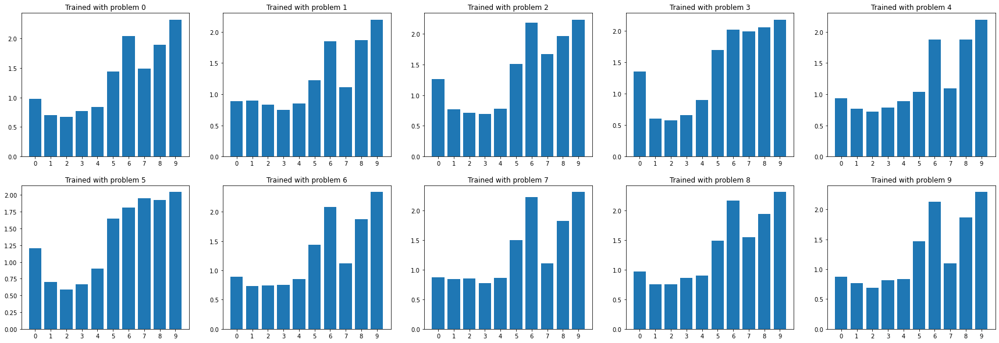

In [140]:
plot_bars(results_stochastic)

# Results (noisy, stochastic)

Executing problem 0
total reward -1.5335356695345768
total reward -0.5533990679772355
total reward -0.6666809493161129
total reward -0.8428102676845406
total reward -1.7768491400692015
total reward -1.930737318501825
total reward -1.7620763374982429
total reward -2.0478421399852493
total reward -2.1230196336310936
total reward -2.160543456921967
Executing problem 1
total reward -1.4110092444264106
total reward -0.5799240658748356
total reward -0.9217483821400868
total reward -1.1108380522745598
total reward -1.7636256128259387
total reward -1.7905267256054003
total reward -1.9773133440985684
total reward -1.8095139752784994
total reward -1.9881719867822605
total reward -2.150413910361075
Executing problem 2
total reward -1.7330885811086123
total reward -0.4335906470697671
total reward -0.8840209767352337
total reward -1.150792815478168
total reward -1.524987872360924
total reward -2.017097240788877
total reward -2.0327652161555565
total reward -1.7665620414023584
total reward -2.028176

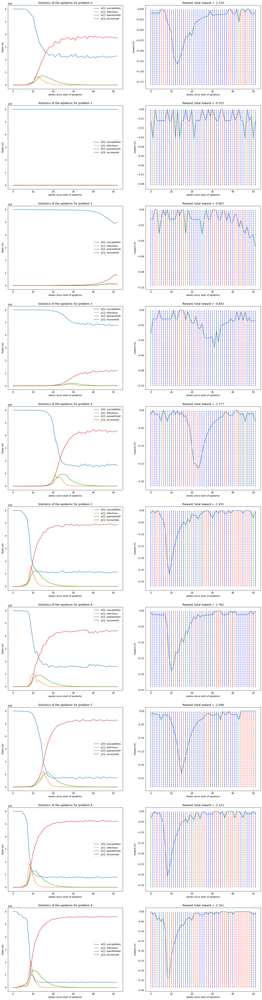

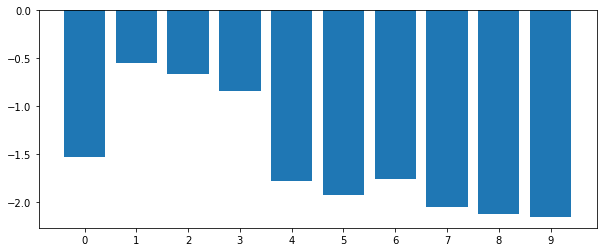

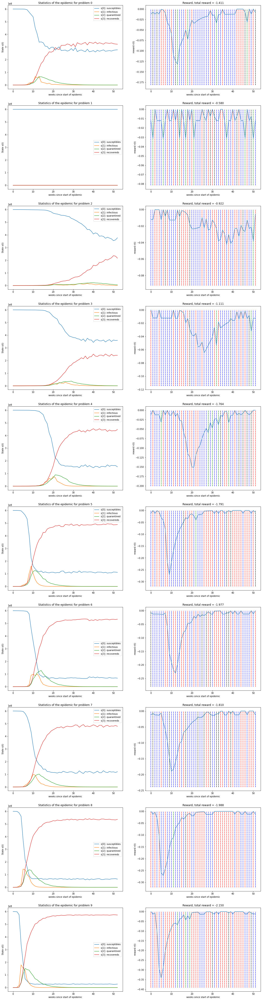

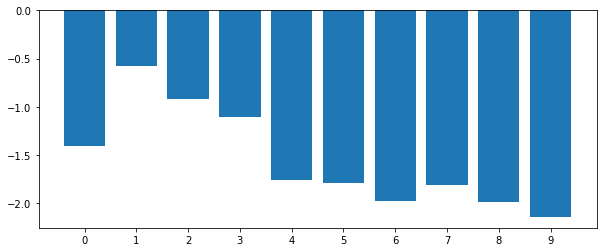

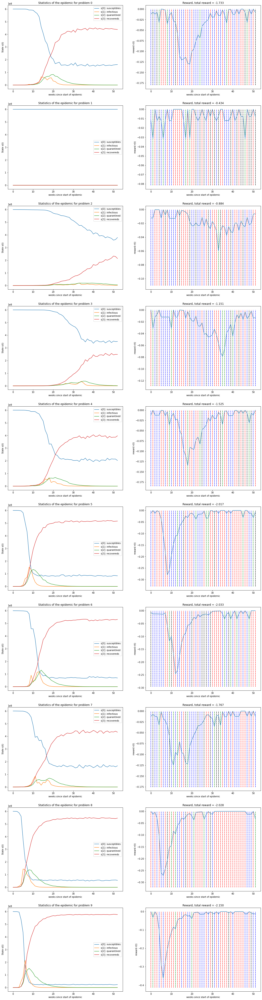

...

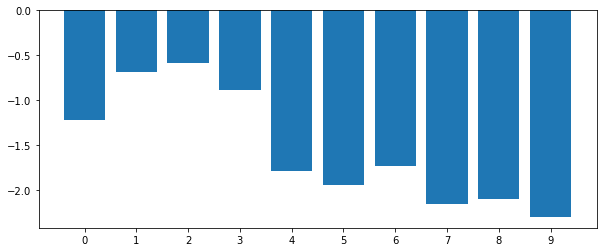

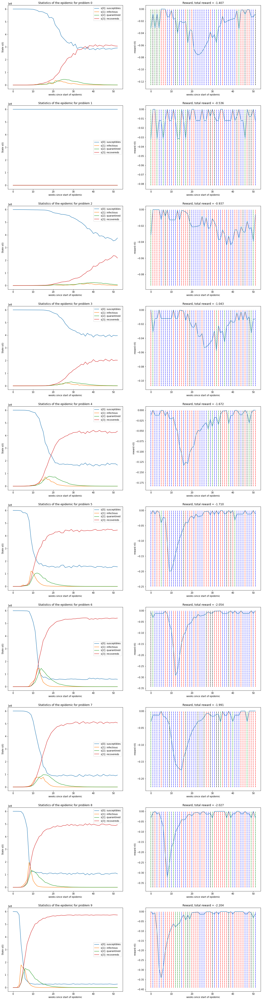

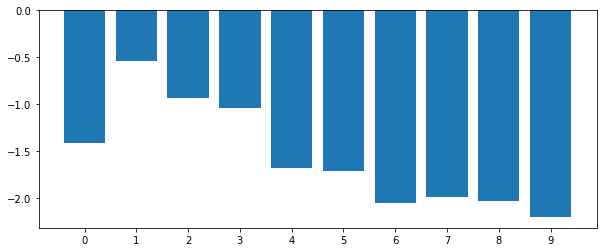

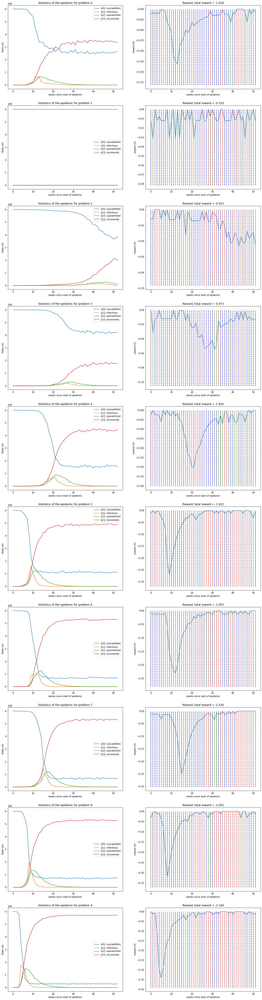

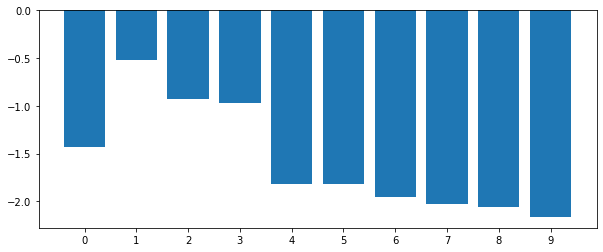

In [106]:
results_noisy_stochastic = []
row_labels = []

GLOBAL_SEED = 42
num_episodes = 50
    
for i in range(10):
    print("Executing problem {}".format(i))
    env = virl.Epidemic(stochastic=True, noisy=True, problem_id=i)
    
    approximator_ps = FunctionApproximator(bin_scaler=2, eta0=0.01)
    stats = policy_search(env, approximator_ps, num_episodes, discount_factor=0.99)
    #plt.plot(stats.episode_rewards)
    #utils.evaluate(create_policy(approximator_ps),)
    
    res = utils.evaluate(create_policy(approximator_ps), full_eval=True, verbose=False, noisy=True)
    results_noisy_stochastic.append([-1*r for r in res])
    row_labels.append("Trained on problem {}".format(i))

In [107]:
print(utils.latex_table(results_noisy_stochastic, row_labels, include_means=True))

Trained on problem 0 & 1.53 & 0.55 & 0.67 & 0.84 & 1.78 & 1.93 & 1.76 & 2.05 & 2.12 & 2.16 & 1.54\\ 
Trained on problem 1 & 1.41 & 0.58 & 0.92 & 1.11 & 1.76 & 1.79 & 1.98 & 1.81 & 1.99 & 2.15 & 1.55\\ 
Trained on problem 2 & 1.73 & \textbf{0.43} & 0.88 & 1.15 & 1.52 & 2.02 & 2.03 & \textbf{1.77} & 2.03 & 2.15 & 1.57\\ 
Trained on problem 3 & 1.83 & 0.6 & 0.72 & 1.13 & 1.55 & 1.75 & 2.07 & 2.13 & 2.07 & 2.16 & 1.6\\ 
Trained on problem 4 & 1.5 & 0.61 & 0.83 & 1.15 & 1.69 & 1.72 & 2.06 & 2.13 & 2.03 & 2.2 & 1.59\\ 
Trained on problem 5 & 1.4 & 0.57 & 0.6 & \textbf{0.79} & \textbf{1.42} & 1.98 & 1.95 & 1.89 & \textbf{1.92} & \textbf{2.0} & \textbf{\underline{1.45}}\\ 
Trained on problem 6 & 1.32 & 0.54 & 0.93 & 1.15 & 1.64 & \textbf{1.71} & 2.04 & 1.99 & 2.0 & 2.21 & 1.55\\ 
Trained on problem 7 & \textbf{1.22} & 0.69 & \textbf{0.58} & 0.89 & 1.79 & 1.95 & \textbf{1.74} & 2.16 & 2.1 & 2.31 & 1.54\\ 
Trained on problem 8 & 1.41 & 0.54 & 0.94 & 1.04 & 1.67 & 1.71 & 2.05 & 1.99 & 2.03 & 2.2 

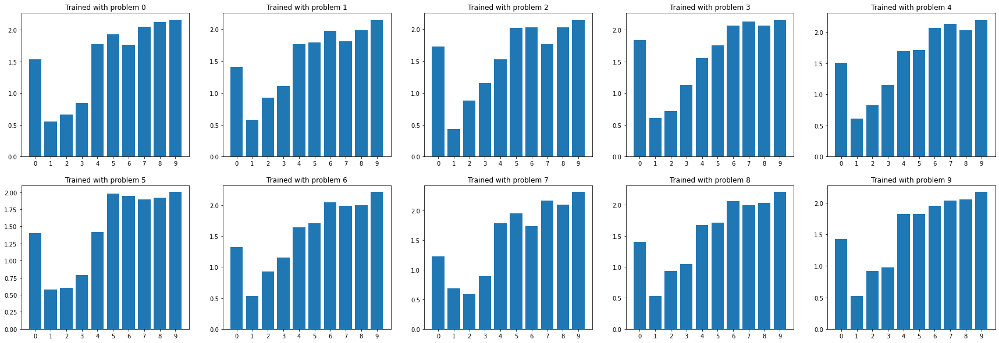

In [141]:
plot_bars(results_noisy_stochastic)